# Texture Analysis - Courseness, Contrast, Directionality, Regularity, Line-Likeness, Roughness

Statistical Features from Brown et al 2022, 'Efficient Dataflow Modeling of Peripheral Encoding in the Human Visual System'. 

Texture statistics adapted from Tamura, Mori & Yamawaki 1978

Note: To run this notebook and reproduce results You'll need to copy the original and metamer image files into this directory either by:  
    1. Copying the entire psychopy experiment file folder structure 'staticimage-master' into the 'texture_features' directory  
    OR  
    2. Changing the 'folder' and 'folder_met' pathnames in the second code block to point to folders containing original and metamer images files, respectively. Texture file names need to be in the 'Tex_001_orig.jpg', and 'Tex_001_metm.jpg' format.  

In [1]:
import numpy as np
import os
import cv2
import matplotlib.pyplot as plt
import multiprocessing
from functools import partial
import texture_features as tft
import imp
import pandas as pd
import copy
pd.set_option('display.float_format', lambda x: '%.5f' % x) #scientific notation gets annoying

from matplotlib.ticker import FormatStrFormatter

## Read in Images

In [2]:
#readin images for original and metamer-ized stims
folder = './staticimage-master/html/resources/images/main/orig/'
folder_met = './staticimage-master/html/resources/images/main/metm/'
#folder = './original_images/'
#folder_met = './metamer_images/'

files = [os.path.join(root, name)
             for root, dirs, files in os.walk(folder)
             for name in files
             if name.endswith("_orig.jpg",)]

#files excluded from experiment due to very low contrast/other issues
ignore_filenames = ['Tex_084_orig.jpg', 'Tex_085_orig.jpg',
                    'Tex_174_orig.jpg', 'Tex_175_orig.jpg',
                    'Tex_328_orig.jpg', 'Tex_329_orig.jpg']

files = [f for f in files if not os.path.basename(f) in ignore_filenames]
print('Number of Images:',len(files))

Number of Images: 394


## Calculate Stats
uncomment to run this the first time - it can take hours to run!

In [3]:
# pool = multiprocessing.Pool(28)

coarseness = pool.map(tft.calc_coarseness, [tft.get_texture(fpath, greyscale=True) for fpath in files[:5]])
contrast = pool.map(tft.calc_contrast_peli, [tft.get_texture(fpath, greyscale=True) for fpath in files[:5]])
directionality = pool.map(partial(tft.calc_directionality), [tft.get_texture(fpath, greyscale=True) for fpath in files[:5]])
linelikeness = pool.map(tft.calc_linelikeness, [tft.get_texture(fpath, greyscale=True) for fpath in files[:5]])
regularity = pool.map(tft.calc_regularity, [tft.get_texture(fpath, greyscale=True) for fpath in files[:5]])
roughness = pool.map(tft.calc_roughness_phasecon, [tft.get_texture(fpath, greyscale=True) for fpath in files[:5]])
deepness = [tft.calc_topside_con_ratio(folder, os.path.basename(fpath)) for fpath in files]
ps_slope = pool.map(tft.fit_alpha_powerspec, [tft.get_texture(fpath, greyscale=True) for fpath in files])

# np.save('stat_values/coarseness.npy', coarseness)
# np.save('stat_values/contrast.npy', contrast)
# np.save('stat_values/directionality.npy', directionality)
# np.save('stat_values/linelikeness.npy', linelikeness)
# np.save('stat_values/regularity.npy', regularity)
# np.save('stat_values/roughness.npy', roughness)
# np.save('stat_values/deepness.npy', deepness)
# np.save('stat_values/ps_slope.npy', ps_slope)

## View Distributions

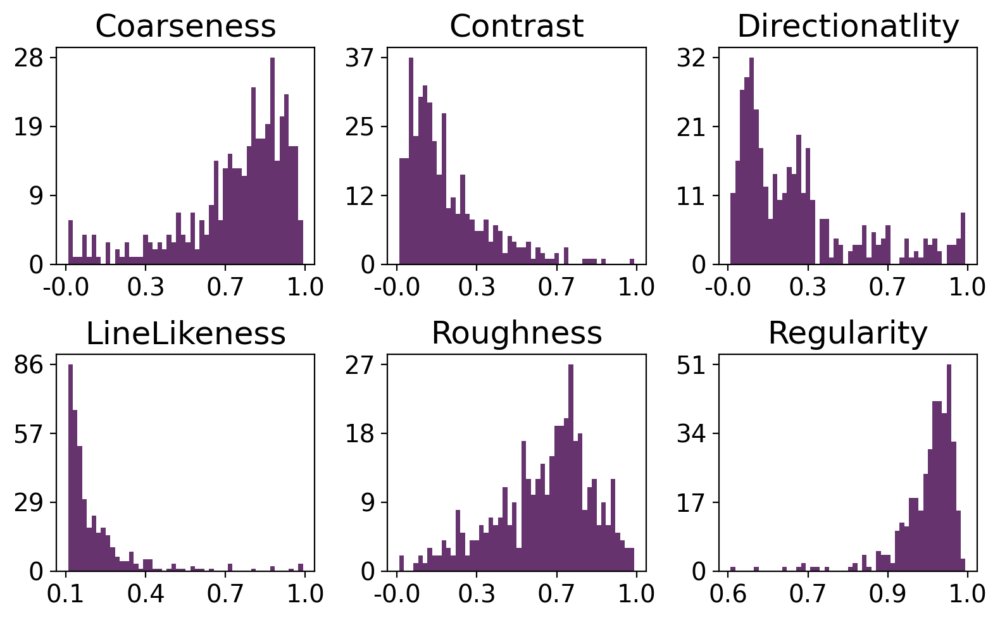

In [4]:
#load
coarseness = np.load('stat_values/coarseness.npy')
contrast = np.load('stat_values/contrast.npy')
directionality = np.load('stat_values/directionality.npy')
linelikeness = np.load('stat_values/linelikeness.npy')
regularity = np.load('stat_values/regularity.npy')
roughness = np.load('stat_values/roughness.npy')
deepness = np.load('stat_values/deepness.npy')
ps_slope = np.load('stat_values/ps_slope.npy')

#used to calculate normalizing constants
# mx_coarseness = np.max(coarseness)
# mx_contrast = np.max(contrast)
# mx_directionality = np.max(directionality)
# mx_linelikeness = np.max(linelikeness)
# mx_regularity= np.max(regularity)
# mx_roughness= np.max(roughness)
# mx_deepness = np.max(deepness)
# mx_psslope =np.max(ps_slope)

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 200
plt.figure(figsize=(8,5))
alpha = 0.8
bins = 50
cm = plt.get_cmap('PRGn')
c = cm(0)
titles = ['Coarseness', 'Contrast','Directionatlity','LineLikeness','Roughness','Regularity']
for i, stat in enumerate([coarseness, contrast, directionality, linelikeness, roughness, regularity]):
    plt.subplot(2,3,i+1)
    title = titles[i]
    ys, xs = np.histogram(stat,bins)
    dx = (xs[1] - xs[0])
    xs = xs[1:] - dx #center of bar not edges
    plt.bar(xs, ys, dx, color=c, alpha=alpha)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    ax = plt.gca()
    ax.xaxis.set_ticks(np.linspace(xs[0]-dx, xs[-1]+dx, num=4))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    ax.yaxis.set_ticks(np.linspace(0, np.max(ys), num=4))
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.0f'))
    #ax.margins(0.04) # or whatever looks good, to not cut off the ends
    plt.title(title, fontsize=18)
    plt.tight_layout()
plt.show();
plt.savefig('StatHists.png')

## Pandas Data Table

In [5]:
texture_filepath = 'texture_statistics_final.csv'

table = zip([os.path.basename(f).replace('Tex_','').replace('_orig.jpg','') for f in files], coarseness, contrast, directionality, linelikeness, regularity, roughness, deepness, ps_slope)
textable_header = ['TexID', 'Coarseness','Contrast','Directionality','LineLikeness','Regularity','Roughness','Deepness','PSSlope']
pdtable = pd.DataFrame(table, columns = textable_header)
pdtable.to_csv(texture_filepath, index=False)

#use this and uncomment above to read in table
#pdtable = pd.read_csv(texture_filepath)

pdtable


,TexID,Coarseness,Contrast,Directionality,LineLikeness,Regularity,Roughness,Deepness,PSSlope
0,281,0.95966,0.50556,0.18888,0.43547,0.92746,0.82688,1.11500,0.20411
1,331,0.98192,0.05953,0.04842,0.17312,0.94326,0.62723,0.89222,0.09999
2,309,0.74615,0.16892,0.31400,0.15601,0.95022,0.70412,1.00984,0.14932
3,333,0.82785,0.05803,0.03356,0.17258,0.91967,0.64584,0.77015,0.12082
4,224,0.86507,0.41068,0.09092,0.27254,0.86993,0.76297,0.92457,0.17368
...,...,...,...,...,...,...,...,...,...
389,195,0.74280,0.04456,0.29311,0.21571,0.93548,0.68566,0.99178,0.18208
390,121,0.72698,0.21932,0.05580,0.17656,0.94106,0.76017,1.14990,0.18404
391,008,0.92149,0.18039,0.08962,0.23990,0.88727,0.66278,1.00000,0.34252
392,230,0.92421,0.27292,0.07727,0.16233,0.94767,0.64525,1.16753,0.10696


## View Ordering

In [6]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 100

def plot_max_min_n(quality, n=15,grey=False):
    sorted_table = pdtable.sort_values(by=[quality], ascending=False)

    plt.figure(figsize=(35,4))
    
    for i in range(n):
        plt.subplot(2,n,i+1)
        tid = sorted_table.iloc[i]['TexID']
        fname = 'Tex_'+str(int(tid)).zfill(3)+'_orig.jpg'
        #plt.imshow(np.mean(get_texture(os.path.join(folder, fname)),axis=-1))
        if(grey):
            plt.imshow(tft.get_texture(os.path.join(folder, fname),greyscale=True),vmin=0,vmax=1,cmap='Greys_r')
        else:
            plt.imshow(tft.get_texture(os.path.join(folder, fname)))
        plt.axis('off')
        if(i==n-1 and grey):
            plt.colorbar()
        #plt.title(f'#{i+1} most {quality}: {fname.replace("_orig.jpg","")}')
        plt.title(f'#{i+1} most {quality}')
        
        plt.subplot(2,n,i+n+1)
        tid = sorted_table.iloc[-(i+1)]['TexID']
        fname = 'Tex_'+str(int(tid)).zfill(3)+'_orig.jpg'
        #plt.imshow(np.mean(get_texture(os.path.join(folder, fname)),axis=-1))
        if(grey):
            plt.imshow(tft.get_texture(os.path.join(folder, fname),greyscale=True),vmin=0,vmax=1,cmap='Greys_r')
        else:
            plt.imshow(tft.get_texture(os.path.join(folder, fname)))
        plt.axis('off')
        if(i==n-1 and grey):
            plt.colorbar()
        #plt.title(f'#{i+1} least {quality}: {fname.replace("_orig.jpg","")}')
        plt.title(f'#{i+1} least {quality}')

    plt.show()

<Figure size 1280x960 with 0 Axes>

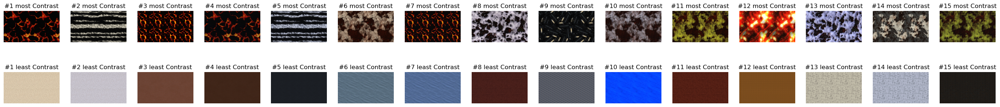

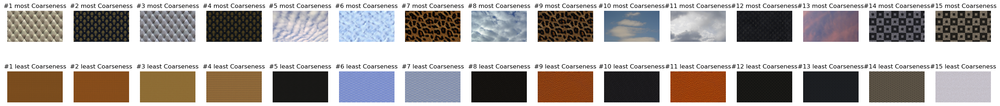

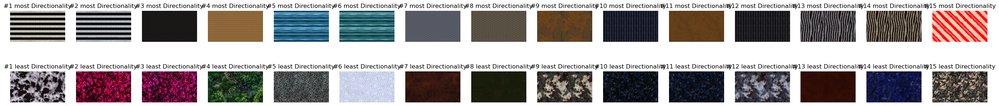

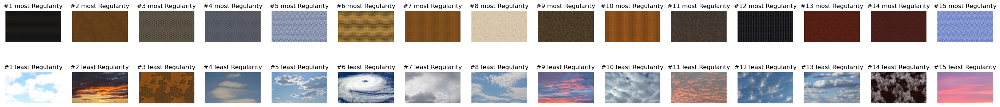

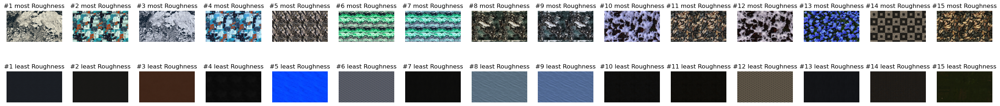

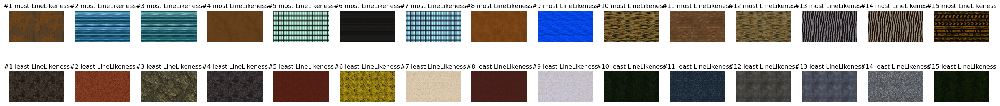

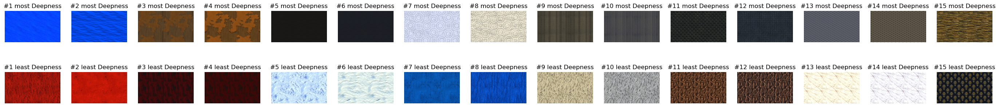

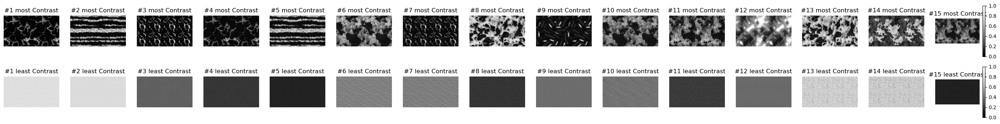

In [7]:
plot_max_min_n('Contrast',grey=False)

plot_max_min_n('Coarseness',grey=False)

plot_max_min_n('Directionality',grey=False)

plot_max_min_n('Regularity',grey=False)

plot_max_min_n('Roughness',grey=False)

plot_max_min_n('LineLikeness',grey=False)

plot_max_min_n('Deepness',grey=False)

plot_max_min_n('Contrast',grey=True)


## Show Large Texture Images (Metamer at Half Eccentricity)

In [8]:
#Split Screen
def make_splitscreen(n):
    ori = tft.get_texture(os.path.join(folder,f'Tex_{str(n).zfill(3)}_orig.jpg'))
    met = tft.get_texture(os.path.join(folder_met,f'Tex_{str(n).zfill(3)}_metm.jpg'))
    split = copy.deepcopy(ori)
    split[:,split.shape[1]//2:,:] = met[:,split.shape[1]//2:,:]
    return(split)

def get_patches_half_ecc(n, patch_size = 512, con_max = 1, norm=True):
    print(os.path.join(folder,f'Tex_{str(n).zfill(3)}_orig.jpg'))
    ori = tft.get_texture(os.path.join(folder,f'Tex_{str(n).zfill(3)}_orig.jpg'))
    print(os.path.join(folder_met,f'Tex_{str(n).zfill(3)}_metm.jpg'))
    met = tft.get_texture(os.path.join(folder_met,f'Tex_{str(n).zfill(3)}_metm.jpg'))
    y_pos_center = ori.shape[0]//2
    x_pos_center = ori.shape[1]//4 #at half eccentricity
    ori_patch = ori[y_pos_center-patch_size//2:y_pos_center+patch_size//2,
                    x_pos_center-patch_size//2:x_pos_center+patch_size//2,:]
    met_patch = met[y_pos_center-patch_size//2:y_pos_center+patch_size//2,
                x_pos_center-patch_size//2:x_pos_center+patch_size//2,:]
    
    if(norm):
        if(np.max(ori_patch) < con_max):
            ori_patch = ori_patch / con_max
        if(np.max(met_patch) < con_max):
            met_patch = met_patch / con_max
        #met_patch = met_patch / (con_max * np.max(met_patch))
        
    return(ori_patch, met_patch)

def get_patch_half_ecc(img, patch_size = 512, norm=True):
    y_pos_center = img.shape[0]//2
    x_pos_center = img.shape[1]//4 #at half eccentricity
    patch = img[y_pos_center-patch_size//2:y_pos_center+patch_size//2,
                x_pos_center-patch_size//2:x_pos_center+patch_size//2,:]
    if(norm):
        patch = patch / (con_max * np.max(patch))
    return(patch)

def histeq(img):
    img_yuv = (cv2.cvtColor(img, cv2.COLOR_BGR2YUV)*255).astype(np.uint8)
    # equalize the histogram of the Y channel
    #lum = np.expand_dims(img_yuv[:,:,0],axis=-1)
    lum = img_yuv[:,:,0]
    #print(lum.shape, lum.dtype)
    #gray = (cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) * 255).astype(np.uint8)
    #print(gray.shape, gray.dtype)
    
    img_yuv[:,:,0] = cv2.equalizeHist(lum)

    # convert the YUV image back to RGB format
    img_output = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)
    
    return(img_output)


# Visualize Original and Metamers for Most and Least Successfull
Results from Psychophysics Experiment: 

In [9]:
lowest_perc_corr = [14,17,50,73,100,103,112,135,194,251,256,259,332,334,339,360,394,395]
highest_perc_corr = [173,210,213,216,226,262,267,289,290,292,294,342,343,352,354,355]
chance_perc_corr = [4, 5, 20, 47, 81, 110, 125, 169]

# 0.482759
# 5.0      0.482759
# 20.0     0.482759
# 47.0     0.482759
# 81.0     0.482759
# 110.0    0.482759
# 111.0    0.482759
# 125.0    0.482759
# 169.0    0.500000
# 189.0    0.482759
# 190.0    0.482759
# 209.0    0.482759
# 218.0    0.482759
# 221.0    0.482759
# 250.0    0.482759
# 252.0    0.482759
# 337.0    0.482759
# 369.0    0.482759
# 370.0    0.482759
# 384.0    0

fail_exemplars = [267,  226, 262, 210, 294] #226
met_exemplars = [4, 384, 194, 125, 81]
#good_exemplars = [17, 73, 194, 339] #251
#chance_exemplars = [4, 5, 20, 47, 81, 110, 125, 169, 189, 190, 209, 218, 221, 250, 252, 337, 369, 384]

### Successfull Metamers

./staticimage-master/html/resources/images/main/orig/Tex_004_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_004_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_384_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_384_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_194_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_194_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_125_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_125_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_081_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_081_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_004_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_004_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_384_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_384_metm.jpg
./staticimage-master

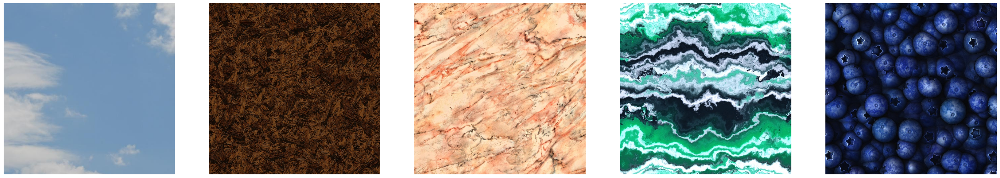

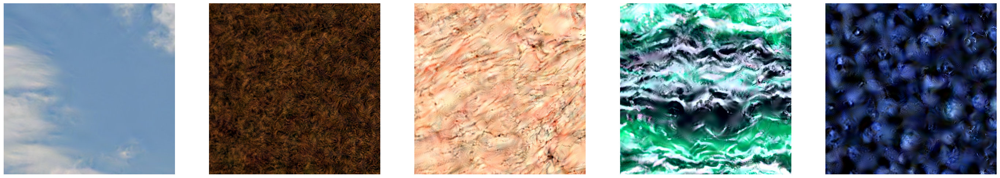

In [10]:
mpl.rcParams['figure.dpi'] = 100
plt.figure(figsize=(35,10))

for i, n in enumerate((met_exemplars)):
    plt.subplot(1,len(met_exemplars),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(true)
    plt.axis('off')
#plt.show();

plt.figure(figsize=(35,10))   
for i, n in enumerate((met_exemplars)):
    plt.subplot(1,len(met_exemplars),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(met)
    plt.axis('off')
plt.show();

### Unsuccessfull Metamers

In [ ]:
mpl.rcParams['figure.dpi'] = 100
plt.figure(figsize=(35,10))

for i, n in enumerate((fail_exemplars)):
    plt.subplot(1,len(fail_exemplars),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(true)
    plt.axis('off')
#plt.show();

plt.figure(figsize=(35,10))   
for i, n in enumerate((fail_exemplars)):
    plt.subplot(1,len(fail_exemplars),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(met)
    plt.axis('off')
plt.show();

## Interaction: High Roughness + High Contrast

In [ ]:
#high contrast, high roughness (good metamer)

high_rgh = pdtable[pdtable['Roughness'] > 0.6]
high_con = high_rgh[high_rgh['Contrast'] > 0.65]
#high_dir
plt.figure(figsize=(35,4))
for i in range(len(high_con)):
    plt.subplot(1,len(high_con),i+1)
    tid = str(int(high_con.iloc[i]['TexID'])).zfill(3)
    fname = 'Tex_'+tid+'_orig.jpg'
    plt.imshow(tft.get_texture(os.path.join(folder, fname)))
    plt.axis('off')
plt.savefig('High_Rough_High_Con.png')
plt.show()

high_con

./staticimage-master/html/resources/images/main/orig/Tex_100_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_100_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_322_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_322_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_298_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_298_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_046_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_046_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_100_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_100_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_322_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_322_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_298_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_298_metm.jpg
./staticimage-master

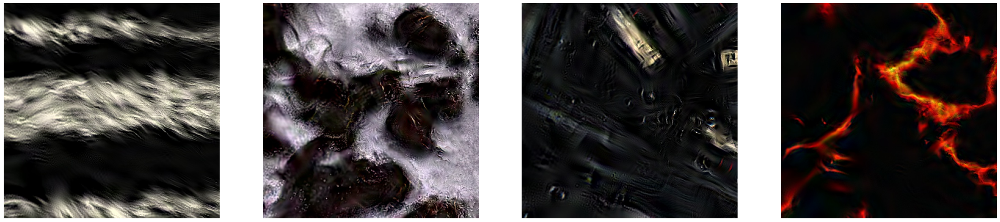

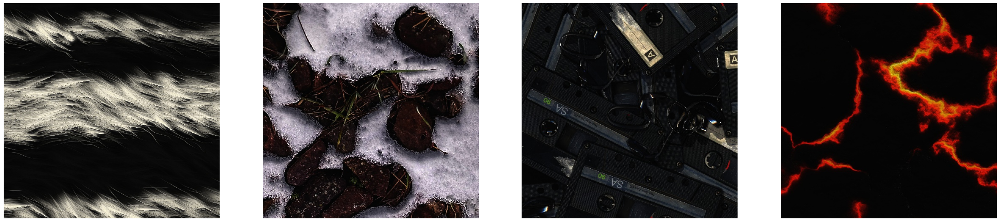

In [13]:
plot_ids = [0,1,2,4]
plot_textures = [int(high_con.iloc[i]['TexID']) for i in plot_ids]

plt.figure(figsize=(35,10))   
for i, n in enumerate(plot_textures):
    plt.subplot(1,len(plot_textures),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(met)
    plt.axis('off')

plt.figure(figsize=(35,10))   
for i, n in enumerate(plot_textures):
    plt.subplot(1,len(plot_textures),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(true)
    plt.axis('off')
plt.show();

## Interaction: Low Coarseness, Low Roughness

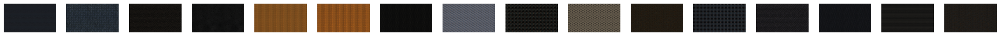

,TexID,Coarseness,Contrast,Directionality,LineLikeness,Regularity,Roughness,Deepness,PSSlope
24,213,0.32148,0.01537,0.57208,0.44640,0.93523,0.00000,2.13810,0.12731
25,203,0.25682,0.05915,0.08576,0.17012,0.94469,0.35455,1.57029,0.17287
55,172,0.05784,0.05446,0.21318,0.20804,0.96513,0.25188,1.02808,0.06263
63,200,0.38460,0.10883,0.38587,0.30217,0.94299,0.33942,0.98193,0.11434
69,029,0.00213,0.02714,0.84274,0.34693,0.96882,0.30457,1.17662,0.00963
72,028,0.00487,0.03193,0.92295,0.30354,0.96809,0.35434,1.17662,0.01467
147,286,0.12606,0.05274,0.38447,0.31389,0.95398,0.12837,1.16648,0.14440
168,211,0.11536,0.02394,0.98534,0.27848,0.97263,0.10142,1.53611,0.07983
184,288,0.07796,0.08349,0.39291,0.22512,0.95743,0.25969,1.14127,0.15974
192,210,0.10616,0.03677,0.98280,0.31008,0.97394,0.17005,1.53611,0.11265


In [14]:
#low coarseness, low roughness (bad metamer)

low_rgh = pdtable[pdtable['Roughness'] < 0.4]
low_cor = low_rgh[low_rgh['Coarseness'] < 0.4]
#high_dir
plt.figure(figsize=(35,4))
for i in range(len(low_cor)):
    plt.subplot(1,len(low_cor),i+1)
    tid = str(int(low_cor.iloc[i]['TexID'])).zfill(3)
    fname = 'Tex_'+tid+'_orig.jpg'
    plt.imshow(tft.get_texture(os.path.join(folder, fname)))
    plt.axis('off')
plt.savefig('Low_Rough_Low_Cor.png')
plt.show()
low_cor

./staticimage-master/html/resources/images/main/orig/Tex_203_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_203_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_172_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_172_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_288_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_288_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_029_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_029_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_203_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_203_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_172_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_172_metm.jpg
./staticimage-master/html/resources/images/main/orig/Tex_288_orig.jpg
./staticimage-master/html/resources/images/main/metm/Tex_288_metm.jpg
./staticimage-master

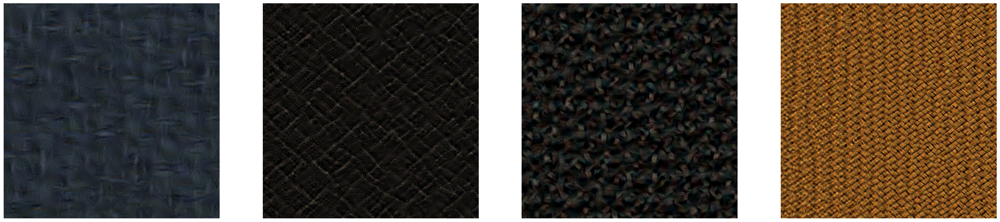

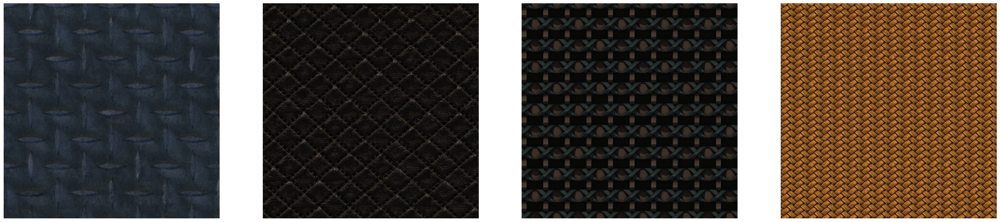

In [15]:
plot_ids = [1,2,8,4]
plot_textures = [int(low_cor.iloc[i]['TexID']) for i in plot_ids]

plt.figure(figsize=(35,10))   
for i, n in enumerate(plot_textures):
    plt.subplot(1,len(plot_textures),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(met)
    plt.axis('off')

plt.figure(figsize=(35,10))   
for i, n in enumerate(plot_textures):
    plt.subplot(1,len(plot_textures),i+1)
    true, met = get_patches_half_ecc(n)
    plt.imshow(true)
    plt.axis('off')
plt.show();

## Interaction: High Directionality + Low Roughness

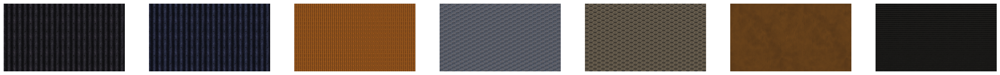

,TexID,Coarseness,Contrast,Directionality,LineLikeness,Regularity,Roughness,Deepness,PSSlope
53,208,0.68828,0.13415,0.96817,0.18058,0.96704,0.34165,0.94120,0.19100
70,209,0.69675,0.14253,0.97118,0.17910,0.96494,0.37108,0.94120,0.18853
72,028,0.00487,0.03193,0.92295,0.30354,0.96809,0.35434,1.17662,0.01467
168,211,0.11536,0.02394,0.98534,0.27848,0.97263,0.10142,1.53611,0.07983
192,210,0.10616,0.03677,0.98280,0.31008,0.97394,0.17005,1.53611,0.11265
251,267,0.76782,0.03297,0.97012,0.95613,0.97497,0.25843,1.40786,0.11224
346,212,0.01496,0.03287,0.99370,0.88564,0.98062,0.01144,2.13810,0.11636


In [16]:
#high directionality, low roughness (bad metamer)

low_rgh = pdtable[pdtable['Roughness'] < 0.4]
high_dir = low_rgh[low_rgh['Directionality'] > 0.9]
#high_dir
plt.figure(figsize=(35,4))
for i in range(len(high_dir)):
    plt.subplot(1,len(high_dir),i+1)
    tid = str(int(high_dir.iloc[i]['TexID'])).zfill(3)
    fname = 'Tex_'+tid+'_orig.jpg'
    plt.imshow(tft.get_texture(os.path.join(folder, fname)))
    plt.axis('off')
plt.savefig('Low_Rough_High_Dir.png')
plt.show()
high_dir